#World Population Analysis:        
<img src=https://www.toonpool.com/user/755/files/overpopulation_89025.jpg width="300" 
     height="200" >

* A force driving the future which cannot be ignored.
* How are WE doing?

#Datasets:
The datasets will DL directly from their URLs except in cases where I was unable to locate one for easy DL or a dataset that I did some cleaning to with excel pror to importing. 
For those I uploaded the dataset to my GitHub account and they are loaded from there.
Original data site for thos efiles in listed here:



1.   [World Population dataset ->BigQuery Console of Public Datasets](https://console.cloud.google.com/bigquery?project=direct-tribute-365923&ws=!1m5!1m4!4m3!1sbigquery-public-data!2sworld_bank_global_population!3spopulation_by_country) or from the [World Bank site](https://data.worldbank.org/indicator/SP.POP.TOTL?end=2021&start=2021&view=map).
2.   Demographic data listed as short_demo.csv and health data as short_health.csv are found at: [UN Department of Economic and Social Affairs
Population Division](https://population.un.org/wpp/Download/Standard/MostUsed/)
3.  Small Infant dataset weas extractred from the UN dataset:United NATIONS DEPARTENT OF ECONOMIC and SOCIAL AFFAIRS, Populations Divison 2022:World Populations Prospects: [Online Edition](https://population.un.org/wpp/Download/Standard/MostUsed/).










Next import the modules used for the data analyis and visualizations:

Includes all imports except for 'import json' which was used to support the **GeoJSON** file imports further down.

In [ ]:
#add libraries for Python
import pandas as pd
import numpy as np
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt

Import the World Population Dataset 1960-2018

In [ ]:
world_pop = pd.read_csv('https://raw.githubusercontent.com/garymdmd/population/main/World_Population.csv')

#Examine the data:
This will be our baasic starting point although we may need to merge with other datasets as we go along to examine various population rlated issues and to make future predicitons.
Examine the data size and see the detail of the data and what state it is.
First we will see how large it is and then we will take a look at the basic structure

In [ ]:
#Let see how big it is by examening the shape
world_pop.shape

(263, 61)

In [ ]:
#FIRST WE ARE GOING TO LOOK AT THE BASIC STRUCTURE by examinig the first 10 rows
world_pop.head(10)

,country,country_code,year_1960,year_1961,year_1962,year_1963,year_1964,year_1965,year_1966,year_1967,...,year_2009,year_2010,year_2011,year_2012,year_2013,year_2014,year_2015,year_2016,year_2017,year_2018
0,Afghanistan,AFG,8996973.0,9169410.0,9351441.0,9543205.0,9744781.0,9956320.0,10174836.0,10399926.0,...,28394813,29185507,30117413,31161376.0,32269589.0,33370794.0,34413603.0,35383128.0,36296400.0,37172386.0
1,Albania,ALB,1608800.0,1659800.0,1711319.0,1762621.0,1814135.0,1864791.0,1914573.0,1965598.0,...,2927519,2913021,2905195,2900401.0,2895092.0,2889104.0,2880703.0,2876101.0,2873457.0,2866376.0
2,Algeria,DZA,11057863.0,11336339.0,11619828.0,11912803.0,12221675.0,12550885.0,12902627.0,13275026.0,...,35333881,35977455,36661444,37383887.0,38140132.0,38923687.0,39728025.0,40551404.0,41389198.0,42228429.0
3,American Samoa,ASM,20123.0,20602.0,21253.0,22034.0,22854.0,23672.0,24462.0,25248.0,...,56683,56079,55759,55667.0,55713.0,55791.0,55812.0,55741.0,55620.0,55465.0
4,Andorra,AND,13411.0,14375.0,15370.0,16412.0,17469.0,18549.0,19647.0,20758.0,...,84463,84449,83747,82427.0,80774.0,79213.0,78011.0,77297.0,77001.0,77006.0
5,Angola,AGO,5454933.0,5531472.0,5608539.0,5679458.0,5735044.0,5770570.0,5781214.0,5774243.0,...,22514281,23356246,24220661,25107931.0,26015780.0,26941779.0,27884381.0,28842484.0,29816748.0,30809762.0
6,Antigua and Barbuda,ATG,54131.0,55001.0,55841.0,56702.0,57641.0,58698.0,59915.0,61241.0,...,86746,88028,89253,90409.0,91516.0,92562.0,93566.0,94527.0,95426.0,96286.0
7,Arab World,ARB,92197753.0,94724510.0,97334442.0,100034179.0,102832760.0,105736431.0,108758610.0,111899364.0,...,346629220,354890042,363158703,371443547.0,379705719.0,387907748.0,396028278.0,404024433.0,411898965.0,419790588.0
8,Argentina,ARG,20481779.0,20817266.0,21153052.0,21488912.0,21824425.0,22159650.0,22494035.0,22828869.0,...,40482788,40788453,41261490,41733271.0,42202935.0,42669500.0,43131966.0,43590368.0,44044811.0,44494502.0
9,Armenia,ARM,1874121.0,1941492.0,2009526.0,2077578.0,2145001.0,2211319.0,2276034.0,2339127.0,...,2888092,2877319,2876538,2884229.0,2897584.0,2912403.0,2925553.0,2936146.0,2944809.0,2951776.0


#First Pass Notes:
So fortunately it is relatively small size with 61 columns and 263 rows. But since later on inthe mapping visualizations I am intersted in separating the countries form the regions we will have to filter out the two groups. SO if you look at index 7 you can see the entry 'Arab World' as an example of a region.

One solution to filter them is to make dataset with just the country codes and then make a list from that dataset and use that list to divide the original dataframe into two groups - one with the areas - for futre analysis - and one just containing the countries to make that analaysis more distinct.

In [ ]:
#first we DL a dataset with just the country codes
c_codes = pd.read_csv('https://gist.githubusercontent.com/tadast/8827699/raw/f5cac3d42d16b78348610fc4ec301e9234f82821/countries_codes_and_coordinates.csv')
#it was not without issues due to extra  quotes coming through and then some leading whitespaces which were stripped off
c_codes = c_codes.applymap(lambda x: x.replace('"', '').lstrip())
#final dataset look like this:
c_codes.head(20)

,Country,Alpha-2 code,Alpha-3 code,Numeric code,Latitude (average),Longitude (average)
0,Afghanistan,AF,AFG,4,33,65
1,Albania,AL,ALB,8,41,20
2,Algeria,DZ,DZA,12,28,3
3,American Samoa,AS,ASM,16,-14.3333,-170
4,Andorra,AD,AND,20,42.5,1.6
5,Angola,AO,AGO,24,-12.5,18.5
6,Anguilla,AI,AIA,660,18.25,-63.1667
7,Antarctica,AQ,ATA,10,-90,0
8,Antigua and Barbuda,AG,ATG,28,17.05,-61.8
9,Argentina,AR,ARG,32,-34,-64


#Make the list:
So now we have a table that has a list of only countries and their ISO-3 codes so we will use that to make a list and then extract the two dataframes (+/- regions) out of our original dataframe. 
[Get list from pandas dataframe column or row](https://stackoverflow.com/questions/22341271/get-list-from-pandas-dataframe-column-or-row) using the tolist. method from Pandas.

In [ ]:
#generate list first
col_one_list = c_codes['Alpha-3 code'].tolist()
print(f"\ncol_one_list:\n{col_one_list}\ntype:{type(col_one_list)}")


col_one_list:
['AFG', 'ALB', 'DZA', 'ASM', 'AND', 'AGO', 'AIA', 'ATA', 'ATG', 'ARG', 'ARM', 'ABW', 'AUS', 'AUT', 'AZE', 'BHS', 'BHR', 'BGD', 'BRB', 'BLR', 'BEL', 'BLZ', 'BEN', 'BMU', 'BTN', 'BOL', 'BOL', 'BIH', 'BWA', 'BVT', 'BRA', 'IOT', 'BRN', 'BRN', 'BGR', 'BFA', 'BDI', 'KHM', 'CMR', 'CAN', 'CPV', 'CYM', 'CAF', 'TCD', 'CHL', 'CHN', 'CXR', 'CCK', 'COL', 'COM', 'COG', 'COD', 'COK', 'CRI', 'CIV', 'CIV', 'HRV', 'CUB', 'CYP', 'CZE', 'DNK', 'DJI', 'DMA', 'DOM', 'ECU', 'EGY', 'SLV', 'GNQ', 'ERI', 'EST', 'ETH', 'FLK', 'FRO', 'FJI', 'FIN', 'FRA', 'GUF', 'PYF', 'ATF', 'GAB', 'GMB', 'GEO', 'DEU', 'GHA', 'GIB', 'GRC', 'GRL', 'GRD', 'GLP', 'GUM', 'GTM', 'GGY', 'GIN', 'GNB', 'GUY', 'HTI', 'HMD', 'VAT', 'HND', 'HKG', 'HUN', 'ISL', 'IND', 'IDN', 'IRN', 'IRQ', 'IRL', 'IMN', 'ISR', 'ITA', 'JAM', 'JPN', 'JEY', 'JOR', 'KAZ', 'KEN', 'KIR', 'PRK', 'KOR', 'KOR', 'KWT', 'KGZ', 'LAO', 'LVA', 'LBN', 'LSO', 'LBR', 'LBY', 'LBY', 'LIE', 'LTU', 'LUX', 'MAC', 'MKD', 'MDG', 'MWI', 'MYS', 'MDV', 'MLI', 'MLT', 'MHL

Now use list to get non-country entries out and with ~ it can do the opposite. Look at: [STATOLOGY](https://www.statology.org/pandas-not-in/). The first we will call **new_world** and the second **area_world**.

In [ ]:
#first generate the list of countries only
new_world=world_pop[world_pop['country_code'].isin(col_one_list)]
new_world.head(10)

,country,country_code,year_1960,year_1961,year_1962,year_1963,year_1964,year_1965,year_1966,year_1967,...,year_2009,year_2010,year_2011,year_2012,year_2013,year_2014,year_2015,year_2016,year_2017,year_2018
0,Afghanistan,AFG,8996973.0,9169410.0,9351441.0,9543205.0,9744781.0,9956320.0,10174836.0,10399926.0,...,28394813,29185507,30117413,31161376.0,32269589.0,33370794.0,34413603.0,35383128.0,36296400.0,37172386.0
1,Albania,ALB,1608800.0,1659800.0,1711319.0,1762621.0,1814135.0,1864791.0,1914573.0,1965598.0,...,2927519,2913021,2905195,2900401.0,2895092.0,2889104.0,2880703.0,2876101.0,2873457.0,2866376.0
2,Algeria,DZA,11057863.0,11336339.0,11619828.0,11912803.0,12221675.0,12550885.0,12902627.0,13275026.0,...,35333881,35977455,36661444,37383887.0,38140132.0,38923687.0,39728025.0,40551404.0,41389198.0,42228429.0
3,American Samoa,ASM,20123.0,20602.0,21253.0,22034.0,22854.0,23672.0,24462.0,25248.0,...,56683,56079,55759,55667.0,55713.0,55791.0,55812.0,55741.0,55620.0,55465.0
4,Andorra,AND,13411.0,14375.0,15370.0,16412.0,17469.0,18549.0,19647.0,20758.0,...,84463,84449,83747,82427.0,80774.0,79213.0,78011.0,77297.0,77001.0,77006.0
5,Angola,AGO,5454933.0,5531472.0,5608539.0,5679458.0,5735044.0,5770570.0,5781214.0,5774243.0,...,22514281,23356246,24220661,25107931.0,26015780.0,26941779.0,27884381.0,28842484.0,29816748.0,30809762.0
6,Antigua and Barbuda,ATG,54131.0,55001.0,55841.0,56702.0,57641.0,58698.0,59915.0,61241.0,...,86746,88028,89253,90409.0,91516.0,92562.0,93566.0,94527.0,95426.0,96286.0
8,Argentina,ARG,20481779.0,20817266.0,21153052.0,21488912.0,21824425.0,22159650.0,22494035.0,22828869.0,...,40482788,40788453,41261490,41733271.0,42202935.0,42669500.0,43131966.0,43590368.0,44044811.0,44494502.0
9,Armenia,ARM,1874121.0,1941492.0,2009526.0,2077578.0,2145001.0,2211319.0,2276034.0,2339127.0,...,2888092,2877319,2876538,2884229.0,2897584.0,2912403.0,2925553.0,2936146.0,2944809.0,2951776.0
10,Aruba,ABW,54211.0,55438.0,56225.0,56695.0,57032.0,57360.0,57715.0,58055.0,...,101455,101669,102046,102560.0,103159.0,103774.0,104341.0,104872.0,105366.0,105845.0


In [ ]:
# then with the use of the ~ operator genrate the opposite DF
area_world=world_pop[~world_pop['country_code'].isin(col_one_list)]
area_world.head(10)

#Clean the data
We will start looking for duplicates and missing values in the data.
First we will check for duplicates:

In [ ]:
print(f'Any duplicates? {new_world.duplicated().values.any()}')

Any duplicates? False


Okay so no duplicates found.

Let us see if there are any missing values and what they are.

In [ ]:
#this method will show any rows containing NaN values i.e. missing
new_world[new_world.isna().any(axis=1)]

,country,country_code,year_1960,year_1961,year_1962,year_1963,year_1964,year_1965,year_1966,year_1967,...,year_2009,year_2010,year_2011,year_2012,year_2013,year_2014,year_2015,year_2016,year_2017,year_2018
68,Eritrea,ERI,1007590.0,1033328.0,1060486.0,1088854.0,1118159.0,1148189.0,1178875.0,1210302.0,...,3119920.0,3170435.0,3213972.0,NaN,NaN,NaN,NaN,NaN,NaN,3452786.0
126,Kuwait,KWT,269029.0,300576.0,337348.0,378746.0,423898.0,472037.0,523166.0,577164.0,...,2821045.0,2991884.0,3168060.0,3348853.0,3526378.0,3690942.0,3835591.0,3956873.0,4056097.0,4137309.0
206,Serbia,SRB,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,7320807.0,7291436.0,7234099.0,7199077.0,7164132.0,7130576.0,7095383.0,7058322.0,7020858.0,6982084.0
258,State of Palestine,PSE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,3689099.0,3786161.0,3882986.0,3979998.0,4076708.0,4173398.0,4270092.0,4367088.0,4454805.0,4569087.0
Eritrea,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3452786.0


In [ ]:
new_world

,country,country_code,year_1960,year_1961,year_1962,year_1963,year_1964,year_1965,year_1966,year_1967,...,year_2009,year_2010,year_2011,year_2012,year_2013,year_2014,year_2015,year_2016,year_2017,year_2018
0,Afghanistan,AFG,8996973.0,9169410.0,9351441.0,9543205.0,9744781.0,9956320.0,10174836.0,10399926.0,...,28394813.0,29185507.0,30117413.0,31161376.0,32269589.0,33370794.0,34413603.0,35383128.0,36296400.0,37172386.0
1,Albania,ALB,1608800.0,1659800.0,1711319.0,1762621.0,1814135.0,1864791.0,1914573.0,1965598.0,...,2927519.0,2913021.0,2905195.0,2900401.0,2895092.0,2889104.0,2880703.0,2876101.0,2873457.0,2866376.0
2,Algeria,DZA,11057863.0,11336339.0,11619828.0,11912803.0,12221675.0,12550885.0,12902627.0,13275026.0,...,35333881.0,35977455.0,36661444.0,37383887.0,38140132.0,38923687.0,39728025.0,40551404.0,41389198.0,42228429.0
3,American Samoa,ASM,20123.0,20602.0,21253.0,22034.0,22854.0,23672.0,24462.0,25248.0,...,56683.0,56079.0,55759.0,55667.0,55713.0,55791.0,55812.0,55741.0,55620.0,55465.0
4,Andorra,AND,13411.0,14375.0,15370.0,16412.0,17469.0,18549.0,19647.0,20758.0,...,84463.0,84449.0,83747.0,82427.0,80774.0,79213.0,78011.0,77297.0,77001.0,77006.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
258,State of Palestine,PSE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,3689099.0,3786161.0,3882986.0,3979998.0,4076708.0,4173398.0,4270092.0,4367088.0,4454805.0,4569087.0
260,Yemen,YEM,5315355.0,5393036.0,5473671.0,5556766.0,5641597.0,5727751.0,5816247.0,5907874.0,...,22516460.0,23154855.0,23807588.0,24473178.0,25147109.0,25823485.0,26497889.0,27168210.0,27834821.0,28498687.0
261,Zambia,ZMB,3070776.0,3164329.0,3260650.0,3360104.0,3463213.0,3570464.0,3681955.0,3797873.0,...,13215139.0,13605984.0,14023193.0,14465121.0,14926504.0,15399753.0,15879361.0,16363507.0,16853688.0,17351822.0
262,Zimbabwe,ZWE,3776681.0,3905034.0,4039201.0,4178726.0,4322861.0,4471177.0,4623351.0,4779827.0,...,12526968.0,12697723.0,12894316.0,13115131.0,13350356.0,13586681.0,13814629.0,14030390.0,14236745.0,14439018.0


So there were a few found but looks like mostly good news. The values missisng make sense for the most part. Serbia considers itsel the same as Yugoslavia, unlike the other Balkan states so it has no population numbers prior to the dissolution of Yugoslavia. Kuwait is missing some years around the first Gulf War. Eritrea is missing the most recent years - it is a complicated country and likewise Palestine does not start counting until 1990. Some of these could be filled in with other datasets but the only one I will fill in is Eritrea in 2018 for one visualization I have in mind. The other points will not specifically cause nay issues.

In [ ]:
#add the population of Eritrea in 2018; 3,452,786
new_world.at[68, 'year_2018'] = 3452786
#alternative method:    
#df.loc[68, 'year_2018'] = 3452786

So now we should be able start thinkng about visualizations. As an intro let us look at the top 20 countries and do a bar plot on those for a speicific year - 2018.

In [ ]:
#pd.options.display.float_format = '{:.0f}'.format.  #this keeps them in real number format
pd.options.display.float_format = '{:,.0f}'.format.   #this keeps them in integer format
top_countries = new_world.sort_values('year_2018')
top20_countries = top_countries[-20:]
top20_countries.loc[:,["country","year_2018"]]

,country,year_2018
236,Thailand,"69,428,524"
111,Iran,"81,800,269"
242,Turkey,"82,319,724"
86,Germany,"82,927,922"
47,Democratic Republic of the Congo,"84,068,091"
256,Vietnam,"95,540,395"
65,Egypt,"98,423,595"
191,Philippines,"106,651,922"
71,Ethiopia,"109,224,559"
155,Mexico,"126,190,788"


In [ ]:
h_bar = px.bar(x=top20_countries.year_2018,
               y=top20_countries.country,
               orientation='h',
               color=top20_countries.year_2018,
               color_continuous_scale='ylorrd',
               title='Top 20 Countries by Number of Population')

h_bar.update_layout(xaxis_title='Population', 
                    yaxis_title='Country',
                    coloraxis_showscale=False)
h_bar.show()

#China and India in tyhe LEAD!!
So this is a great visualizaiton tool and probaly the most obvious visual is that China and India have left the 'rest of us' far behind. So we can see from looking at the output that the world map will have to be manipulated to be useful as if we use a scale broad enough to capture all the countries it is esseentially only a 2 colored map showing China and India as one color and the rest of the world as another color. So let's run this bar graph one more time with China and India out and see if that is more interesting.

First find India and China index using [Country Column Values](https://www.statology.org/pandas-select-rows-based-on-column-values/)

In [ ]:
new_world.loc[new_world['country'].isin(["India", "China"])]

,country,country_code,year_1960,year_1961,year_1962,year_1963,year_1964,year_1965,year_1966,year_1967,...,year_2009,year_2010,year_2011,year_2012,year_2013,year_2014,year_2015,year_2016,year_2017,year_2018
44,China,CHN,"667,070,000","660,330,000","665,770,000","682,335,000","698,355,000","715,185,000","735,400,000","754,550,000",...,"1,331,260,000","1,337,705,000","1,344,130,000","1,350,695,000","1,357,380,000","1,364,270,000","1,371,220,000","1,378,665,000","1,386,395,000","1,392,730,000"
109,India,IND,"450,547,679","459,642,165","469,077,190","478,825,608","488,848,135","499,123,324","509,631,500","520,400,576",...,"1,217,726,215","1,234,281,170","1,250,288,729","1,265,782,790","1,280,846,129","1,295,604,184","1,310,152,403","1,324,509,589","1,338,658,835","1,352,617,328"


In [ ]:
#now that we have their index location let us remove them and create another dataframe of the rest of us.
small_world = new_world.drop([44,109],axis=0)
top_countries = small_world.sort_values('year_2018')
top30_countries = top_countries[-30:]
top30_countries.loc[:,["country","year_2018"]]

,country,year_2018
8,Argentina,"44,494,502"
247,Ukraine,"44,622,516"
220,Spain,"46,723,749"
45,Colombia,"49,648,685"
121,Kenya,"51,393,010"
124,South Korea,"51,635,256"
167,Myanmar (formerly Burma),"53,708,395"
235,Tanzania,"56,318,348"
216,South Africa,"57,779,622"
116,Italy,"60,431,283"


##New Map
So we can now rerun the plot and see if there is more variation in the coloring scale.

In [ ]:
h_bar = px.bar(x=top30_countries.year_2018,
               y=top30_countries.country,
               orientation='h',
               color=top30_countries.year_2018,
               color_continuous_scale='ylorrd',
               title='Top 30 Countries (- China & India) by Population')

h_bar.update_layout(xaxis_title='Population', 
                    yaxis_title='Country',
                    coloraxis_showscale=False)
h_bar.show()

To get a good overview we will use [ChloroPleth Mapbox](https://plotly.com/python/mapbox-county-choropleth/) from Plotly to see population map illustrated with color with a time line slider on the bottom. We have all the data we need to do this except we need to get the right[ Geo.JSON file](https://plotly.com/python/mapbox-county-choropleth/#mapbox-access-tokens-and-base-map-configuration)s to be able to use the  slider. To get this file we will go to GitHub Repo from [johan/geo.json](https://github.com/johan/world.geo.json). Also we need to ouse the urlopen method from [urllib](https://www.geeksforgeeks.org/python-urllib-module/). More GeoJSON info found [here on github-Johan](https://stackoverflow.com/questions/65313444/plotly-mapbox-base-map-world-covid-cases-geojson-file)

##MELT Method to match Mapping:
There is one other manipulation we have to do to the data before using this method and that is to tranpose the dataframe wso that the populations are listed as rows instead of in columns. For this we will use the melt method and sort them by country_code and the year.[ Convert columns into multiple rows in pandas dataframe](https://stackoverflow.com/questions/50098113/convert-columns-into-multiple-rows-in-pandas-dataframe) and python pandas, certain [columns to rows](https://stackoverflow.com/questions/19842066/python-pandas-certain-columns-to-rows)


In [ ]:
#first we need a list of column headings
column_headings = new_world.columns
#we will put those columns in the melt method
column_headings

Index(['country', 'country_code', 'year_1960', 'year_1961', 'year_1962',
       'year_1963', 'year_1964', 'year_1965', 'year_1966', 'year_1967',
       'year_1968', 'year_1969', 'year_1970', 'year_1971', 'year_1972',
       'year_1973', 'year_1974', 'year_1975', 'year_1976', 'year_1977',
       'year_1978', 'year_1979', 'year_1980', 'year_1981', 'year_1982',
       'year_1983', 'year_1984', 'year_1985', 'year_1986', 'year_1987',
       'year_1988', 'year_1989', 'year_1990', 'year_1991', 'year_1992',
       'year_1993', 'year_1994', 'year_1995', 'year_1996', 'year_1997',
       'year_1998', 'year_1999', 'year_2000', 'year_2001', 'year_2002',
       'year_2003', 'year_2004', 'year_2005', 'year_2006', 'year_2007',
       'year_2008', 'year_2009', 'year_2010', 'year_2011', 'year_2012',
       'year_2013', 'year_2014', 'year_2015', 'year_2016', 'year_2017',
       'year_2018'],
      dtype='object')

In [ ]:
#now put the year columns in their own list to pass to the melt method
melt_col_list=['year_1960', 'year_1961', 'year_1962',
       'year_1963', 'year_1964', 'year_1965', 'year_1966', 'year_1967',
       'year_1968', 'year_1969', 'year_1970', 'year_1971', 'year_1972',
       'year_1973', 'year_1974', 'year_1975', 'year_1976', 'year_1977',
       'year_1978', 'year_1979', 'year_1980', 'year_1981', 'year_1982',
       'year_1983', 'year_1984', 'year_1985', 'year_1986', 'year_1987',
       'year_1988', 'year_1989', 'year_1990', 'year_1991', 'year_1992',
       'year_1993', 'year_1994', 'year_1995', 'year_1996', 'year_1997',
       'year_1998', 'year_1999', 'year_2000', 'year_2001', 'year_2002',
       'year_2003', 'year_2004', 'year_2005', 'year_2006', 'year_2007',
       'year_2008', 'year_2009', 'year_2010', 'year_2011', 'year_2012',
       'year_2013', 'year_2014', 'year_2015', 'year_2016', 'year_2017',
       'year_2018']

In [ ]:
melt_set_world = pd.melt(new_world, id_vars=['country','country_code'], value_vars= melt_col_list)

In [ ]:
#then we willsort them by country code and then years
melt_set_world =melt_set_world.sort_values(["country_code","variable"])
melt_set_world


,country,country_code,variable,value
9,Aruba,ABW,year_1960,"54,211"
222,Aruba,ABW,year_1961,"55,438"
435,Aruba,ABW,year_1962,"56,225"
648,Aruba,ABW,year_1963,"56,695"
861,Aruba,ABW,year_1964,"57,032"
...,...,...,...,...
11714,NaN,NaN,year_2014,NaN
11927,NaN,NaN,year_2015,NaN
12140,NaN,NaN,year_2016,NaN
12353,NaN,NaN,year_2017,NaN


##Geojson data
Now we need dto get the Geojson data file for the world to help populate the chlorpleth map. GeoJSON info found [here on github-Johan](https://stackoverflow.com/questions/65313444/)

In [ ]:
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/johan/world.geo.json/master/countries.geo.json') as response:
    world = json.load(response)

Now we can use the chloropleth mapbox method using the original new_world datframe and take a look - we expect China and India to loom large.

In [ ]:
fig = px.choropleth_mapbox(
    data_frame=melt_set_world,
    geojson=world,
    locations="country_code",
    color="value",
    hover_name="country",
    animation_frame="variable",
    color_continuous_scale=px.colors.sequential.Plasma,
    range_color=(0, 1400000000),
    mapbox_style="carto-positron",
    zoom=1,
    title="World Population Map"
)

# Show the map
fig.show()

This visual is such a great way to see the world grow. You can see how India finally catches up to its neighbor China right at the endof the series. Youcan also see how many countries did not increase at all like - Russia.
YOu can run the enitre thing again with China and India out to get a better idea of relative growth intherest of the world.In this visual we changed the highest value to 400 million instaed of 1.5 billion in the first world map.

In [ ]:
melt_small_world = pd.melt(small_world, id_vars=['country','country_code'], value_vars= melt_col_list)
melt_small_world =melt_small_world.sort_values(["country_code","variable"])


fig = px.choropleth_mapbox(
    data_frame=melt_small_world,
    geojson=world,
    locations="country_code",
    color="value",
    hover_name="country",
    animation_frame="variable",
    color_continuous_scale=px.colors.sequential.Plasma,
    range_color=(0, 400000000),
    mapbox_style="carto-positron",
    zoom=1,
    title="World Population Map"
)

# Show the map
fig.show()


##New Perspective:
Now this current map of -China -India does help to bring out the relative changes in the rest of the world. You can see the unique changes in countries in Africa like Egypt, Ethiopia,DRC as well Nigeria. It also high lights the growth in Indonesia and shows Pakistan more acutely. You also see well the lack of change in Eastern Europe even more and Russia and many South American Countries they were less obvious before.

#Population Density:
Now lets look at another similar parameter and see how the same maps technique compare - population **density**. For this we will first get another dataset.
We will get density with data.world map [data.world](https://data.world/jst5th/country-population-land-area-density)

In [ ]:
densityO = pd.read_excel('https://query.data.world/s/5us73tp24v743nmj5o4abwa43247b5')
densityO.head()

,Country,Population (2020),Land Area (Km²),Density (P/Km²)
0,Afghanistan,"38,041,750","652,230",57
1,Albania,"2,854,190","28,748",105
2,Algeria,"43,053,050","2,381,740",18
3,Andorra,"77,140",468,164
4,Angola,"31,825,290","1,246,700",25


So let us change the column names to make them easier to work with and to merge them based on country with current dataframe

In [ ]:
densityO.rename(columns = {'Country' : 'country','Density (P/Km²)' : 'density','Population (2020)':'year_2020','Land Area (Km²)':'Land_Area_km'}, inplace = True)
densityO.head()

,country,year_2020,Land_Area_km,density
0,Afghanistan,"38,041,750","652,230",57
1,Albania,"2,854,190","28,748",105
2,Algeria,"43,053,050","2,381,740",18
3,Andorra,"77,140",468,164
4,Angola,"31,825,290","1,246,700",25


We need to check the datatypes so we know we can use the numbers as we make calculations

In [ ]:
result = densityO.dtypes
print(result)

country         object
year_2020       object
Land_Area_km    object
density         object
dtype: object


Need to change the datatype to float in the **area** category so as to use it to calculate the population density after w e merge this dataset with our population dataset. What follows is the one that worked, in the case that there were some str values causing issues. Alsowe merged the dataset on the couontry column in both datasets which was not without issues.

In [ ]:
#this statement has some extras built to take care of any values that were not consistent and gets rid of extra quotes
densityO['Land_Area_km'] = densityO['Land_Area_km'].apply(lambda x: float(str(x).replace(",", "")))

In [ ]:
result = densityO.dtypes
print(result)

country          object
year_2020        object
Land_Area_km    float64
density          object
dtype: object


Checking datatypes again we see that the Land_Area_km has been changed to float type as we wanted.

We are only intersted in the land area so we will drop two other columns from this dataframe 'year_2020'and 'density'.

In [ ]:
densityO = densityO.drop(labels=['year_2020', 'density'], axis=1)
#world_merged = world_merged.drop(labels='year_2020', axis=1)
#world_merged = world_merged.drop(labels='density', axis=1)

##Merging:
Merging the two are simple and will occur onthe column country - they have in common. But can be a problem if there are some missing countries or ones that have their names listed differently. So lets check that out

In [ ]:
density_col_list = densityO['country'].tolist()


In [ ]:
density_col_list

In [ ]:
miss_world=new_world[~new_world['country'].isin(density_col_list)]
miss_world

So there are 20 countries missing but they are all rather small and average density i am guessing so I think fo rnow we will be okay leaving them out after the merging, rather than look for anohter dataset of densities (which in the real case would be appropriate). So we will go ahead with the merging

In [ ]:
world_merged = new_world.merge(densityO)

In [ ]:
world_merged

In [ ]:
world_merged.shape

(193, 62)

So now we will run the search the other way and itwill show any countries that were in the Densisty DF but were not in the Original WOrld population dataframe.

In [ ]:
miss_world=densityO[~densityO['country'].isin(country_col_list)]
miss_world

,country,Land_Area_km
73,Holy See,0
146,Saint Vincent and the Grenadines,389


So this way there is even a smaller number and again both countries we can afford to drop for our purposes. So now are set to proceed.

In [ ]:
result = world_merged.dtypes
print(result)

country          object
country_code     object
year_1960       float64
year_1961       float64
year_1962       float64
                 ...   
year_2015       float64
year_2016       float64
year_2017       float64
year_2018       float64
Land_Area_km    float64
Length: 62, dtype: object


In [ ]:
col1, col2 = world_merged.columns[:2]


# create an empty dictionary to store the transformed columns
transformed_columns = {col1: world_merged[col1], col2: world_merged[col2]}

# iterate over the remaining columns and apply the transformation
for col in world_merged.columns[2:]:
    transformed_columns[f'{col}'] = world_merged[col]/world_merged['Land_Area_km']

# create a new DataFrame using the transformed columns
new_df = pd.DataFrame(transformed_columns, index=world_merged.index)

print(new_df)

In [ ]:
melt_dense_world = pd.melt(new_df, id_vars=['country','country_code'], value_vars=['year_1960', 'year_1961', 'year_1962',
       'year_1963', 'year_1964', 'year_1965', 'year_1966', 'year_1967',
       'year_1968', 'year_1969', 'year_1970', 'year_1971', 'year_1972',
       'year_1973', 'year_1974', 'year_1975', 'year_1976', 'year_1977',
       'year_1978', 'year_1979', 'year_1980', 'year_1981', 'year_1982',
       'year_1983', 'year_1984', 'year_1985', 'year_1986', 'year_1987',
       'year_1988', 'year_1989', 'year_1990', 'year_1991', 'year_1992',
       'year_1993', 'year_1994', 'year_1995', 'year_1996', 'year_1997',
       'year_1998', 'year_1999', 'year_2000', 'year_2001', 'year_2002',
       'year_2003', 'year_2004', 'year_2005', 'year_2006', 'year_2007',
       'year_2008', 'year_2009', 'year_2010', 'year_2011', 'year_2012',
       'year_2013', 'year_2014', 'year_2015', 'year_2016', 'year_2017',
       'year_2018'])

In [ ]:
melt_dense_world =melt_dense_world.sort_values(["country_code","variable"])

In [ ]:
fig = px.choropleth_mapbox(
    data_frame=melt_dense_world,
    geojson=world,
    locations="country_code",
    color="value",
    hover_name="country",
    animation_frame="variable",
    color_continuous_scale=px.colors.sequential.Plasma,
    range_color=(0, 700),
    mapbox_style="carto-positron",
    zoom=1,
    title="World Density Map"
)

# Show the map
fig.show()

#Individual Country Densities:
Before leaving the density visualizations it is important to bring up anohter dataset which shows a more detailed view of the world with denisty maps showing the distribution of density in and individual country.[Algeria](https://hub.worldpop.org/geodata/summary?id=44968)

<img src="https://hub.worldpop.org/tabs/gdata/img/44968/dza_pd_1km_UN_2007_Image.png" width ="400" height="400">

#Projections and Linear Regression Analysis:
Now we would like to look at some world data by country and indictors and see what are the best predictors looking at a country's future.


#DATA comes from UNFPA 
United Nations Populations Fund [Population Data Portal](https://pdp.unfpa.org/?_ga=2.117262598.1608774276.1672599539-610759127.1670535445)
#Demographics:
First we will look at some Demographic tables

In [ ]:
demo_data = pd.read_csv('https://raw.githubusercontent.com/garymdmd/population/main/short_demo.csv')

In [ ]:
demo_data.head()

In [ ]:
result = demo_data.dtypes
print(result)

In [ ]:
demo_data.columns

In [ ]:
columns = ['population', 'pop_change', 'zero_14', '10_19',
       '10_24', '15_64', '65_more', 'female_fert', 'male_LE', 'femail_LE']

In [ ]:
demo_data[columns] = demo_data[columns].apply(lambda x: pd.to_numeric(x.astype(str).str.replace(',','').str.replace('-','')))

In [ ]:
result = demo_data.dtypes
print(result)

In [ ]:
# Create a scatter plot using the 'x' and 'y' columns in the dataframe with a trendline
fig = px.scatter(demo_data, x="male_LE", y="pop_change", trendline="ols")
# Show the plot
fig.show()

In [ ]:
# Create a scatter plot using the 'x' and 'y' columns in the dataframe with a trendline
fig = px.scatter(demo_data, x="femail_LE", y="pop_change", trendline="ols")
# Show the plot
fig.show()

In [ ]:
import plotly.graph_objects as go

# First set of data
#data1 = px.data.gapminder().query("year == 2007")
fig1 = px.scatter(demo_data, x="femail_LE", y="pop_change", trendline="ols")

# Second set of data
#data2 = px.data.gapminder().query("year == 1952")
fig2 = px.scatter(demo_data, x="male_LE", y="pop_change", trendline="ols")

# Add the second set of data to the first figure
fig1.add_scatter(x=fig2.data[0].x, y=fig2.data[0].y, mode="markers")

# Get the x and y data for the trend line of the second set of data
x_data = fig2.data[1].x
y_data = fig2.data[1].y

# Add a trend line for the second set of data
fig1.add_trace(go.Scatter(x=fig2.data[1].x, y=fig2.data[1].y, mode="lines", line=dict(color="green")))

fig1.show()

In [ ]:
# Create a scatter plot using the 'x' and 'y' columns in the dataframe with a trendline
fig = px.scatter(demo_data, x="female_fert", y="pop_change", trendline="ols")
# Show the plot
fig.show()

All these plots suggest trends that may contribute to women's health and female human rights.

#Contraception and Health:
Looking more at health issue like contraception/hiv

#Import IPCD Health 2022 
from [UN Department of Economic and Social Affairs
Population Division](https://population.un.org/wpp/Download/Standard/MostUsed/)

In [ ]:
health_df = pd.read_csv('https://raw.githubusercontent.com/garymdmd/population/main/short_health.csv')

In [ ]:
health_df.head()

In [ ]:
health_df.columns

Index(['ISO2', 'country', 'MMR', 'MMR_LE', 'MMR_UE', 'attended_birth',
       'new_hiv', 'female_con', 'married_fc', 'mm_fc', 'mm_fc_m', 'unmet_fc',
       'unmey_fc_m', 'deman_MC', 'Lwas', 'UHC'],
      dtype='object')

In [ ]:
columns=['MMR', 'MMR_LE', 'MMR_UE', 'attended_birth',
       'new_hiv', 'female_con', 'married_fc','mm_fc', 'mm_fc_m', 'unmet_fc',
       'unmey_fc_m', 'deman_MC', 'Lwas', 'UHC']

In [ ]:
health_df[columns] = health_df[columns].apply(lambda x: pd.to_numeric(x.astype(str).str.replace(',','').str.replace('-','')))

In [ ]:
result = health_df.dtypes
print(result)

In [ ]:
# Create a scatter plot using the 'x' and 'y' columns in the dataframe with a trendline
fig = px.scatter(health_df, x="attended_birth", y="UHC", trendline="ols")
# Show the plot
fig.show()

#UHC
UHC refers to an indicator or Universal Health Coverage, the higher the better coverage of course.

In [ ]:
# Create a scatter plot using the 'x' and 'y' columns in the dataframe with a trendline
fig = px.scatter(health_df, x="UHC", y="MMR", trendline="ols")
# Show the plot
fig.show()

In [ ]:
# Create a scatter plot using the 'x' and 'y' columns in the dataframe with a trendline
fig = px.scatter(health_df, x="UHC", y="female_con", trendline="ols")
# Show the plot
fig.show()

#Seaborn package and analysis of Population varibles:
Using data from the United NATIONS DEPARTENT OF ECONOMIC and SOCIAL AFFAIRS, Populations Divison 2022:World Populations Prospects: [Online Edition](https://population.un.org/wpp/Download/Standard/MostUsed/).

Looking at some of the above data to see what varibles drive infant mortality. First we willimport a subset of data from the above dataset.

In [ ]:
# Read the Excel file
small_inf = pd.read_excel('https://github.com/garymdmd/population/raw/main/small_infant_2021.xlsx', sheet_name='SuSm_21')

# Print the dataframe
small_inf.head()

,"Region, subregion, country or area *",ISO3,Total Population,Population Density,Population Sex Ratio,Median Age,Population Growth Rate,Births,Total Fertility Rate,Mean Age Childbearing,Female Deaths,Crude Death Rate,Male Life Expectancy,Female Life Expectancy,Infant Deaths under age 1,Infant Mortality Rate
0,Nigeria,NGA,210874.214,234.309,102.134,17.020,2.369,7923.294,5.237,29.482,1370.181,13.083,52.285,53.070,576.683,73.037
1,Sierra Leone,SLE,8327.732,117.377,100.406,18.832,2.207,264.106,3.978,28.718,36.995,9.113,58.758,61.354,19.018,72.012
2,Somalia,SOM,16801.170,27.203,100.537,15.188,3.099,743.932,6.312,29.334,91.684,11.596,53.246,57.414,52.689,71.197
3,Chad,TCD,16910.218,13.643,100.787,14.997,3.138,744.834,6.255,29.343,100.400,12.504,50.845,54.283,50.589,68.235
4,Lesotho,LSO,2268.596,75.147,97.399,22.082,1.127,59.581,3.018,27.882,15.250,14.186,50.374,55.927,4.029,67.545


In [ ]:
small_inf.columns

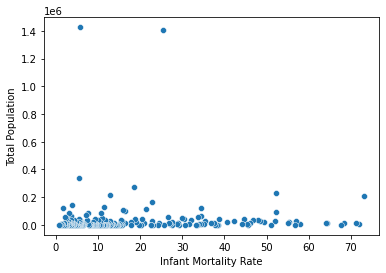

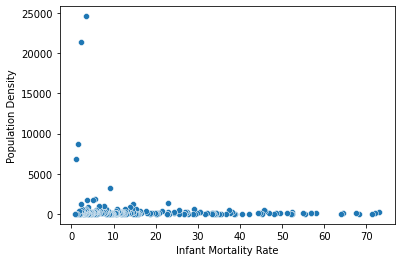

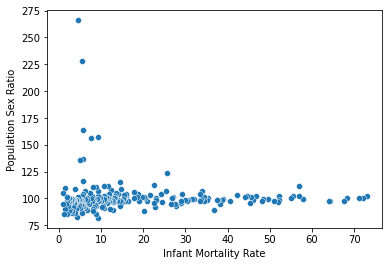

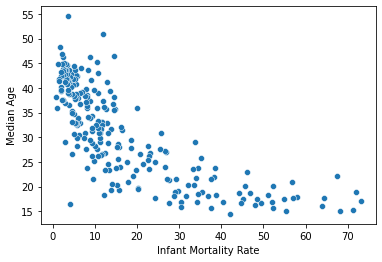

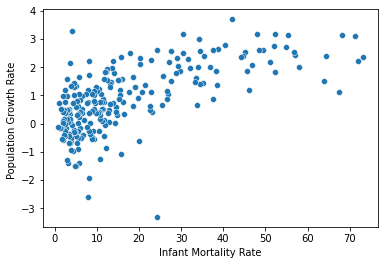

...

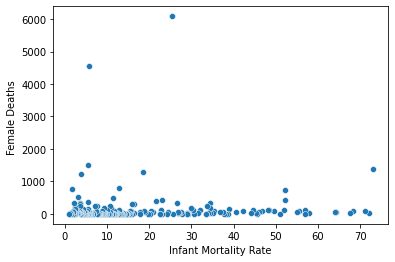

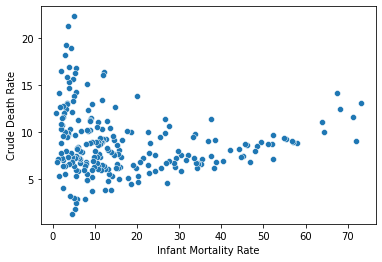

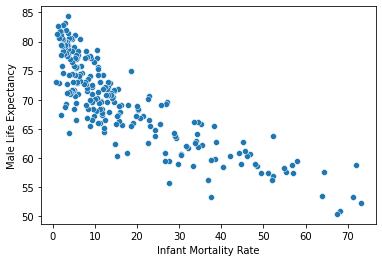

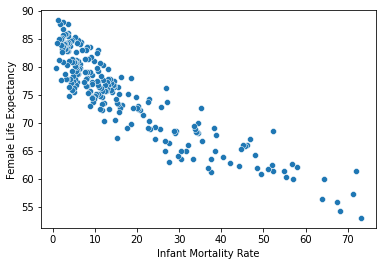

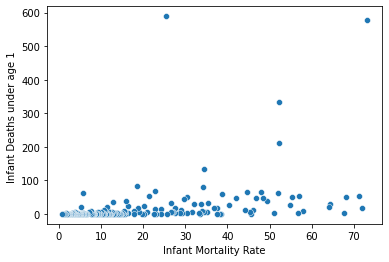

In [ ]:
# Select the columns to include in the plots
columns = ['Total Population','Population Density', 'Population Sex Ratio', 'Median Age',
       'Population Growth Rate ', 'Births ', 'Total Fertility Rate ',
       'Mean Age Childbearing', 'Female Deaths ', 'Crude Death Rate',
       'Male Life Expectancy', 'Female Life Expectancy',
       'Infant Deaths under age 1 ', 'Infant Mortality Rate']
#df = df[columns]

# Loop through the columns
for col in columns:
  # Skip the current column if it is the same as the x-axis column
  if col == 'Infant Mortality Rate':
    continue
  
  # Create a scatter plot
  sns.scatterplot(x='Infant Mortality Rate', y=col, data=small_inf)
  
  # Show the plot
  plt.show()

#Linear regression:
Looking at the graphs above it appears that he strongest relationship is between female lifespan and infant mortality. There is a fair corelatio wiht male lifespan as well but little correlations with the other variables in this dataset.Belwo is the single plot with a linear regression line drawn that is a nice fit.

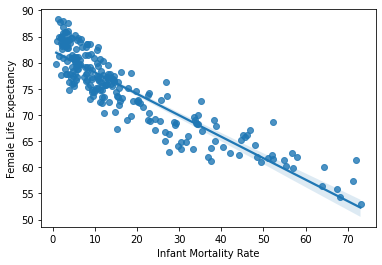

In [ ]:
#This work s well for an indivdiual plot

sns.regplot(x='Infant Mortality Rate', y='Female Life Expectancy', data=small_inf)

This plot shows a convincing relationship of correlation between female life expectancy and infant mortality. Not surprising if there is a large amoount of maternal mortality, as I would suscepect there is.

#Discussion to this point:
There are a lot of intersting facets of populatioin datasets and there is a lot of data to look at. I hope to add some Machine learning to this project and try to find varibles and models to make predicitons. I also intend to do some webscraping ot get some less accessible data and analyze some of them. For now I hope this is a good addtion to my portfolio and I need to spend some time on job applications and searches January 01 2023.
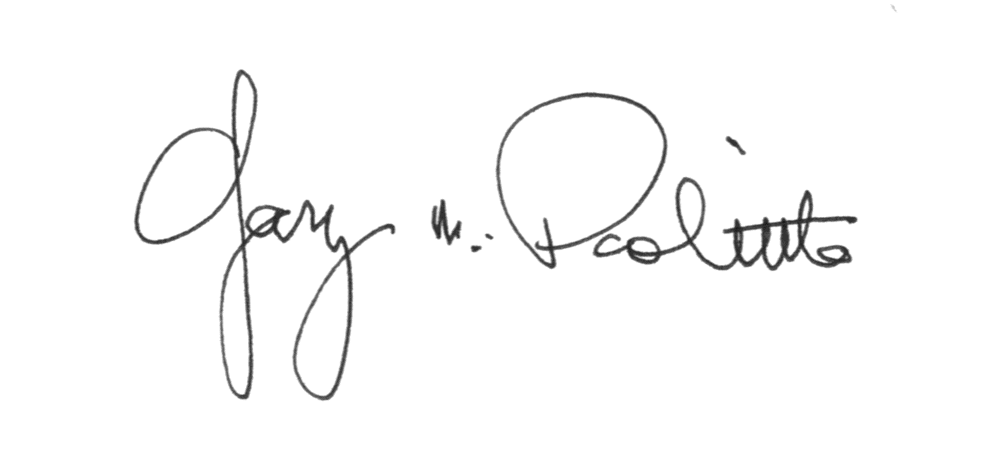